```yaml
Equipo: Data Heroes
Integrantes:
    - Paul E. Arizpe Colorado
    - Tania Gúzman Aguirre
    - M. Fernanda Martínez Campos
Grupo: 801
Carrera: LCDN
Sede: Coyoacán
```

### Carga de librerias necesarias

In [57]:
import os
import re
import string
import warnings
import numpy as np
import pandas as pd
import nltk
from nltk import word_tokenize, sent_tokenize
from nltk.corpus import stopwords
from nltk.tag import hmm
from nltk.text import TextCollection
from nltk.stem.porter import PorterStemmer
from tqdm.notebook import tqdm
from datetime import datetime as dt
from wordcloud import WordCloud, ImageColorGenerator
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from tensorflow.keras.preprocessing.text import text_to_word_sequence, Tokenizer, one_hot
import tensorflow as tf
from shapely.geometry import Point, LineString
import geopandas as gpd
import folium
import osmnx as ox
import contextily as ctx
import requests

from collections import Counter
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.special import softmax

warnings.filterwarnings('ignore')

# Descargamos los recursos necesarios de NLTK
nltk.download('punkt')
nltk.download('punkt_tab')
nltk.download('stopwords')

# Cargamos las stopwords en español
stop_words = stopwords.words('spanish')

# Para realizar el stemming
stemmer = PorterStemmer()

[nltk_data] Downloading package punkt to E:\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt_tab to E:\nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!
[nltk_data] Downloading package stopwords to E:\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [2]:
print(nltk.__version__)
print(tf.__version__)
print(pd.__version__)

3.9.1
2.19.0
2.2.3


In [3]:
# Carga de documento
def load_doc(pathfile):
    with open(pathfile, 'rt', encoding='utf-8') as file:
        content = file.read()
    return content

In [4]:
# Test Load Document
doc = load_doc('../../tweets/quejas/1.txt')
print(doc)

Reporte 30, día 30
El taller Popocatépetl Motors ( propiedad de 
@LuisMendozaBJ
 ) usa el carril del RTP como estacionamiento y extensión de su patio de maniobras, bloquea banquetas y pasos peatonales. Debido a esto es el causante de varios accidentes viales. 
@UCS_GCDMX
 
@SSC_CDMX


In [5]:
# Limpieza de texto
def clean_text(text):
    # Tokenizar el texto
    tokens = word_tokenize(text)
    
    # Eliminar signos de puntuación y convertir a minúsculas
    re_punc = re.compile('[%s]' % re.escape(string.punctuation))
    tokens = [re_punc.sub('', w) for w in tokens]
    tokens = [word.lower() for word in tokens if word.isalpha()]
    
    # Eliminar stopwords
    stop_words = set(stopwords.words('spanish'))
    tokens = [w for w in tokens if not w in stop_words]
    
    # Eliminar palabras de un solo carácter
    tokens = [word for word in tokens if len(word) > 1]
    
    return tokens

In [6]:
# test clean_text
tokens = clean_text(doc)
print(tokens[:10])  # Muestra las primeras 10 palabras tokenizadas

['reporte', 'día', 'taller', 'popocatépetl', 'motors', 'propiedad', 'luismendozabj', 'usa', 'carril', 'rtp']


In [7]:
# 
def doc_to_line(filename, vocab):
    doc = load_doc(filename)
    tokens = clean_text(doc)
    tokens = [w for w in tokens if w in vocab]
    return ''.join(tokens)

In [8]:
# Test doc_to_line
filename = '../../tweets/quejas/1.txt'
vocab = Counter({'rtp': 1, 'queja': 2, 'reclamo': 3, 'servicio': 4, 'reporte': 5})
doc2line = doc_to_line(filename, vocab)
print(doc2line)

reportertp


In [9]:
vocab

Counter({'reporte': 5, 'servicio': 4, 'reclamo': 3, 'queja': 2, 'rtp': 1})

In [10]:
# Función para procesar los documentos de quejas y sugerencias
def process_docs(directory, vocab, is_train):
    lines = list()

    for filename in tqdm(os.listdir(directory)):
        pathfile = rf'{directory}/{filename}'
        texto = doc_to_line(pathfile, vocab)
        print(f'Archivo cargado: {filename}')
        print(texto)
        lines.append(texto)
    return lines

In [11]:
# Test process_docs
directory = '../../tweets/quejas'
is_train = True
lines = process_docs(directory, vocab, is_train)
lines

  0%|          | 0/20 [00:00<?, ?it/s]

Archivo cargado: 1.txt
reportertp
Archivo cargado: 10.txt
rtpservicioservicio
Archivo cargado: 11.txt
servicio
Archivo cargado: 12.txt
serviciortp
Archivo cargado: 14.txt

Archivo cargado: 16.txt
servicio
Archivo cargado: 18.txt

Archivo cargado: 31.txt
serviciortp
Archivo cargado: 32.txt

Archivo cargado: 33.txt
rtp
Archivo cargado: 34.txt
rtpservicio
Archivo cargado: 35.txt
quejartp
Archivo cargado: 36.txt
rtp
Archivo cargado: 37.txt
rtp
Archivo cargado: 38.txt

Archivo cargado: 39.txt
serviciortp
Archivo cargado: 40.txt

Archivo cargado: 5.txt
rtp
Archivo cargado: 7.txt
servicio
Archivo cargado: 8.txt
rtp


['reportertp',
 'rtpservicioservicio',
 'servicio',
 'serviciortp',
 '',
 'servicio',
 '',
 'serviciortp',
 '',
 'rtp',
 'rtpservicio',
 'quejartp',
 'rtp',
 'rtp',
 '',
 'serviciortp',
 '',
 'rtp',
 'servicio',
 'rtp']

In [12]:
def save_list(lines, filname):
    data = '\n'.join(lines)
    with open(filname, 'w') as file:
        file.write(data)

In [13]:
# - Actualizar el vocabulario con las palabras procesadas de cada documento
def update_vocab(vocab, tokens):
    vocab.update(tokens)
    return vocab

In [14]:
# - Procesar los documentos de las quejas y sugerencias y generar un vocabulario.
def process_docs_and_update_vocab(directory, vocab):
    print(f'Procesando documentos en el directorio: {directory}')
    for filename in tqdm(os.listdir(directory)):
        if filename.endswith('.txt'):
            pathfile = f'{directory}/{filename}'
            texto = load_doc(pathfile)
            tokens = clean_text(texto)
            vocab = update_vocab(vocab, tokens)
    return vocab

In [15]:
# - Filtrar las palabras que aparecen con una frecuencia mayor o igual al umbral (5 en este caso) y guardarlas en un archivo.
def save_vocab(lines, filename):
    data = '\n'.join(lines)
    if os.path.exists(filename):
        # Si existe el archivo, agregamos el nuevo vocabulario al final
        with open(filename, 'a+', encoding='utf-8') as file:
            file.write('\n')
            file.write(data)
    else:
        # No existe el archivo, lo creamos
        with open(filename, 'w', encoding='utf-8') as file:
            file.write(data)
    print(f'Vocabulario guardado en: {filename}')

In [16]:
def load_clean_dataset(dir1, dir2, vocab, is_train):
    negative = process_docs(dir1, vocab, is_train)
    positive = process_docs(dir2, vocab, is_train)

    docs = negative + positive #Lista que contiene tanto las quejas como las sugerencias procesadas
    
    labels = [0 for _ in range(len(negative))] + [1 for _ in range(len(positive))]
    return docs, labels

### Preparación de datos 

In [17]:
vocab = Counter()
umbral = 5
tokens = []
directories = ['../../tweets/quejas/', '../../tweets/sugerencias/']
for directory in tqdm(directories):
    vocab = process_docs_and_update_vocab(directory, vocab)
    tokens += [k for k, c in vocab.items() if c >= umbral]

# Guardamos el vocabulario en un archivo
unique_vocab = set(tokens)
save_vocab(unique_vocab, 'vocab.txt')

  0%|          | 0/2 [00:00<?, ?it/s]

Procesando documentos en el directorio: ../../tweets/quejas/


  0%|          | 0/20 [00:00<?, ?it/s]

Procesando documentos en el directorio: ../../tweets/sugerencias/


  0%|          | 0/20 [00:00<?, ?it/s]

Vocabulario guardado en: vocab.txt


In [18]:
vocab_filename = 'vocab.txt'
vocab = load_doc(vocab_filename)
vocab = vocab.split()
vocab = set(vocab)
print(vocab)

{'rtpciudaddemex', 'rtp', 'si', 'hoy', 'ruta', 'servicio', 'metro', 'día', 'santa', 'rutas', 'va', 'ciudad', 'mirtp', 'unidades', 'personas'}


In [19]:
# Cargar datos de entrenamiento y prueba
dir1 = r'D:\Workspace\ws_python\computo_cognitivo_labs\tweets\quejas'
dir2 = r'D:\Workspace\ws_python\computo_cognitivo_labs\tweets\sugerencias'
train_docs, y_train = load_clean_dataset(dir1, dir2, vocab, is_train=True)
test_docs, y_test = load_clean_dataset(dir1, dir2, vocab, is_train=False)

  0%|          | 0/20 [00:00<?, ?it/s]

Archivo cargado: 1.txt
díartp
Archivo cargado: 10.txt
rtpciudadserviciometroserviciortpciudaddemex
Archivo cargado: 11.txt
metroserviciounidadesrtpciudaddemexpersonas
Archivo cargado: 12.txt
serviciortpciudaddemexrutasrtpsantametro
Archivo cargado: 14.txt

Archivo cargado: 16.txt
servicio
Archivo cargado: 18.txt

Archivo cargado: 31.txt
serviciorutasantapersonasrtp
Archivo cargado: 32.txt
rutasantava
Archivo cargado: 33.txt
rtp
Archivo cargado: 34.txt
rtpciudadunidadesrutaservicio
Archivo cargado: 35.txt
rtpdíahoyrutasanta
Archivo cargado: 36.txt
rtp
Archivo cargado: 37.txt
rtp
Archivo cargado: 38.txt

Archivo cargado: 39.txt
serviciortpmetrounidadesunidades
Archivo cargado: 40.txt

Archivo cargado: 5.txt
rtpmetro
Archivo cargado: 7.txt
serviciorutartpciudaddemex
Archivo cargado: 8.txt
rtpdía


  0%|          | 0/20 [00:00<?, ?it/s]

Archivo cargado: 13.txt
mirtppersonas
Archivo cargado: 15.txt
mirtpdíadía
Archivo cargado: 17.txt
vahoy
Archivo cargado: 19.txt
mirtprutasantapersonasservicio
Archivo cargado: 2.txt
mirtp
Archivo cargado: 20.txt
rutasvartprutasunidadesrutasi
Archivo cargado: 21.txt
rutasvartprutasunidadesrutasi
Archivo cargado: 22.txt

Archivo cargado: 23.txt
unidadessivartp
Archivo cargado: 24.txt
rtpciudaddemex
Archivo cargado: 25.txt
unidadessi
Archivo cargado: 26.txt

Archivo cargado: 27.txt
serviciohoyrtpciudadsiservicio
Archivo cargado: 28.txt
unidadesrtpciudad
Archivo cargado: 29.txt
hoy
Archivo cargado: 3.txt
rutartpciudaddemexdíaciudadrtpmetrociudad
Archivo cargado: 30.txt
mirtpservicio
Archivo cargado: 4.txt
mirtprutasanta
Archivo cargado: 6.txt
rtp
Archivo cargado: 9.txt
rutartphoyrtpciudaddemexsantapersonas


  0%|          | 0/20 [00:00<?, ?it/s]

Archivo cargado: 1.txt
díartp
Archivo cargado: 10.txt
rtpciudadserviciometroserviciortpciudaddemex
Archivo cargado: 11.txt
metroserviciounidadesrtpciudaddemexpersonas
Archivo cargado: 12.txt
serviciortpciudaddemexrutasrtpsantametro
Archivo cargado: 14.txt

Archivo cargado: 16.txt
servicio
Archivo cargado: 18.txt

Archivo cargado: 31.txt
serviciorutasantapersonasrtp
Archivo cargado: 32.txt
rutasantava
Archivo cargado: 33.txt
rtp
Archivo cargado: 34.txt
rtpciudadunidadesrutaservicio
Archivo cargado: 35.txt
rtpdíahoyrutasanta
Archivo cargado: 36.txt
rtp
Archivo cargado: 37.txt
rtp
Archivo cargado: 38.txt

Archivo cargado: 39.txt
serviciortpmetrounidadesunidades
Archivo cargado: 40.txt

Archivo cargado: 5.txt
rtpmetro
Archivo cargado: 7.txt
serviciorutartpciudaddemex
Archivo cargado: 8.txt
rtpdía


  0%|          | 0/20 [00:00<?, ?it/s]

Archivo cargado: 13.txt
mirtppersonas
Archivo cargado: 15.txt
mirtpdíadía
Archivo cargado: 17.txt
vahoy
Archivo cargado: 19.txt
mirtprutasantapersonasservicio
Archivo cargado: 2.txt
mirtp
Archivo cargado: 20.txt
rutasvartprutasunidadesrutasi
Archivo cargado: 21.txt
rutasvartprutasunidadesrutasi
Archivo cargado: 22.txt

Archivo cargado: 23.txt
unidadessivartp
Archivo cargado: 24.txt
rtpciudaddemex
Archivo cargado: 25.txt
unidadessi
Archivo cargado: 26.txt

Archivo cargado: 27.txt
serviciohoyrtpciudadsiservicio
Archivo cargado: 28.txt
unidadesrtpciudad
Archivo cargado: 29.txt
hoy
Archivo cargado: 3.txt
rutartpciudaddemexdíaciudadrtpmetrociudad
Archivo cargado: 30.txt
mirtpservicio
Archivo cargado: 4.txt
mirtprutasanta
Archivo cargado: 6.txt
rtp
Archivo cargado: 9.txt
rutartphoyrtpciudaddemexsantapersonas


In [20]:
# Crear el tokenizador y entrenarlo con los datos de entrenamiento
tokenizer = Tokenizer()
tokenizer.fit_on_texts(train_docs)

In [21]:
train_docs, y_train

(['díartp',
  'rtpciudadserviciometroserviciortpciudaddemex',
  'metroserviciounidadesrtpciudaddemexpersonas',
  'serviciortpciudaddemexrutasrtpsantametro',
  '',
  'servicio',
  '',
  'serviciorutasantapersonasrtp',
  'rutasantava',
  'rtp',
  'rtpciudadunidadesrutaservicio',
  'rtpdíahoyrutasanta',
  'rtp',
  'rtp',
  '',
  'serviciortpmetrounidadesunidades',
  '',
  'rtpmetro',
  'serviciorutartpciudaddemex',
  'rtpdía',
  'mirtppersonas',
  'mirtpdíadía',
  'vahoy',
  'mirtprutasantapersonasservicio',
  'mirtp',
  'rutasvartprutasunidadesrutasi',
  'rutasvartprutasunidadesrutasi',
  '',
  'unidadessivartp',
  'rtpciudaddemex',
  'unidadessi',
  '',
  'serviciohoyrtpciudadsiservicio',
  'unidadesrtpciudad',
  'hoy',
  'rutartpciudaddemexdíaciudadrtpmetrociudad',
  'mirtpservicio',
  'mirtprutasanta',
  'rtp',
  'rutartphoyrtpciudaddemexsantapersonas'],
 [0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  1,
  1,
  1,
  1,
  1,
  

### Creando un mapa para mapear los reportes

In [22]:
# Cargamos los datos de las estaciones de RTP
gdf_rtp = gpd.read_file("../DATASET/rtp_shp/RTP_paradas.shp")
gdf_rtp

,RUTA,MODULO,SENTIDO,ORIG_DEST,CORREDOR,INSTERSECC,SISTEMA,geometry
0,115-A,1,SN,San Bartolo Ameyalco (Cafeteros) - Metro Chapu...,None,Ixtlahuaca,Red de Transporte de Pasajeros,POINT Z (-99.27207 19.33469 0)
1,115-A,1,SN,San Bartolo Ameyalco (Cafeteros) - Metro Chapu...,None,Potrero de Tepito,Red de Transporte de Pasajeros,POINT Z (-99.26808 19.33713 0)
2,115-A,1,SN,San Bartolo Ameyalco (Cafeteros) - Metro Chapu...,None,Calz. Las Águilas,Red de Transporte de Pasajeros,POINT Z (-99.26418 19.33937 0)
3,115-A,1,SN,San Bartolo Ameyalco (Cafeteros) - Metro Chapu...,None,Estrellas Colgate,Red de Transporte de Pasajeros,POINT Z (-99.2595 19.34062 0)
4,115-A,1,SN,San Bartolo Ameyalco (Cafeteros) - Metro Chapu...,None,Parque Axomiatla,Red de Transporte de Pasajeros,POINT Z (-99.25432 19.34202 0)
...,...,...,...,...,...,...,...,...
8127,9-D,1,NS,Centro Comercial Santa Fe - San Bartolo Ameyal...,None,Calz. de las Águilas,Red de Transporte de Pasajeros,POINT Z (-99.26399 19.33957 0)
8128,9-D,1,NS,Centro Comercial Santa Fe - San Bartolo Ameyal...,None,Potrero de Tepito,Red de Transporte de Pasajeros,POINT Z (-99.26807 19.33727 0)
8129,9-D,1,NS,Centro Comercial Santa Fe - San Bartolo Ameyal...,None,Ixtlahuaca,Red de Transporte de Pasajeros,POINT Z (-99.27193 19.33487 0)
8130,9-D,1,NS,Centro Comercial Santa Fe - San Bartolo Ameyal...,None,Cafeteros,Red de Transporte de Pasajeros,POINT Z (-99.27481 19.33267 0)


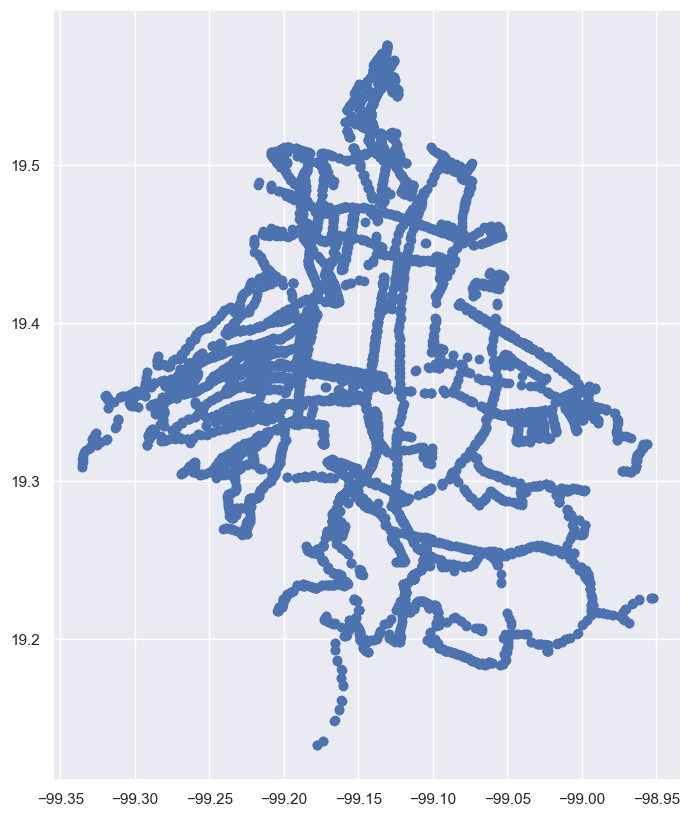

In [24]:
# Mapeamos usando Matplotlib
sns.set_theme()

fig, ax = plt.subplots(figsize=(10, 10))
gdf_rtp.plot(ax=ax)
plt.show()

In [49]:
# Generamos el mapa usando Folium
m = folium.Map(location=[19.4326, -99.1332], zoom_start=12, tiles='cartodb positron')
m

In [50]:
# Exploramos los datos de las estaciones de RTP
gdf_rtp.explore(
    m=m,
    column="RUTA",
    tooltip="ORIG_DEST",
    popup=True, 
    zoom=13
)
# Volvemos a visualizar el mapa
m

> Se visualizan todas las estaciones de RTP que atraviesan por la CDMX

In [45]:
import polars as pl
# Cargamos las incidencias del SUAC
df = pl.read_csv('https://archivo.datos.cdmx.gob.mx/suac/locatel0311-completa.csv', infer_schema_length=10000)
df_app = df.filter(pl.col('tipo_de_entrada') == 'APP CDMX')
# Filtramos y transformamos los datos
df_app = df_app.filter(
    pl.col('fecha_concluido') != 'NA'
).with_columns(
    pl.col("fecha_solicitud").str.strptime(pl.Date, "%Y-%m-%d"),
    pl.col("fecha_concluido").str.strptime(pl.Date, "%Y-%m-%d")
)
df_app

id_folio,fecha_solicitud,hora_solicitud,tipo_de_entrada,tema_solicitud,sexo,edad,estatus,fecha_concluido,alcaldia,colonia_datos,0311_colonia_registro,codigo_postal_solicitud,latitud,longitud
str,date,str,str,str,str,str,str,date,str,str,str,str,f64,f64
"""- 94817""",2019-09-02,"""09:21:57""","""APP CDMX""","""RECONSTRUCCIÓN""","""FEMENINO""","""1""","""ATENDIDO""",2021-09-03,"""NA""","""NA""","""NA""","""00000""",0.0,0.0
"""- 133674""",2019-09-27,"""15:52:14""","""APP CDMX""","""QUEJA DE TRANSPORTE PUBLICO""","""FEMENINO""","""1""","""ATENDIDO""",2019-10-10,"""VENUSTIANO CARRANZA""","""VALLE GOMEZ""","""VALLE GOMEZ""","""00000""",19.456098,-99.119845
"""- 198080""",2019-11-17,"""09:54:41""","""APP CDMX""","""QUEJA DE TRANSPORTE PUBLICO""","""FEMENINO""","""1""","""ATENDIDO""",2019-12-29,"""MIGUEL HIDALGO""","""DANIEL GARZA (AMPL)""","""OBSERVATORIO""","""00000""",19.407029,-99.192459
"""- 7064""",2019-06-05,"""10:20:08""","""APP CDMX""","""BACHEO""","""FEMENINO""","""1""","""ATENDIDO""",2019-07-16,"""NA""","""NA""","""NA""","""00000""",0.0,0.0
"""- 7081""",2019-06-05,"""10:25:46""","""APP CDMX""","""FUGA DE AGUA""","""FEMENINO""","""1""","""ATENDIDO""",2020-01-13,"""BENITO JUAREZ""","""INSURGENTES SAN BORJA""","""NOCHE BUENA""","""00000""",19.383076,-99.175498
…,…,…,…,…,…,…,…,…,…,…,…,…,…,…
"""- 1646321""",2022-10-16,"""19:56:29""","""APP CDMX""","""VERIFICACIÓN ADMINISTRATIVA""","""FEMENINO""","""1""","""TURNADO""",2022-11-15,"""CUAUHTEMOC""","""NA""","""CENTRO""","""00000""",0.0,0.0
"""- 1660205""",2022-10-25,"""13:42:10""","""APP CDMX""","""MANTENIMIENTO VÍA PÚBLICA""","""FEMENINO""","""1""","""CERRADO""",2022-10-25,"""CUAUHTEMOC""","""NA""","""CENTRO""","""00000""",0.0,0.0
"""- 1660969""",2022-10-25,"""21:30:53""","""APP CDMX""","""FUGA DE AGUA""","""FEMENINO""","""1""","""TURNADO""",2022-10-30,"""CUAUHTEMOC""","""NA""","""CENTRO""","""00000""",0.0,0.0


In [46]:
# Limpiamos los datos de latitud y longitud, el tipo de queja
df_reportes = df_app.filter(
    (pl.col('latitud') != 0) & 
    (pl.col('longitud') != 0) &
    (pl.col('tema_solicitud') == 'QUEJA DE TRANSPORTE PUBLICO')
).to_pandas()

df_reportes

,id_folio,fecha_solicitud,hora_solicitud,tipo_de_entrada,tema_solicitud,sexo,edad,estatus,fecha_concluido,alcaldia,colonia_datos,0311_colonia_registro,codigo_postal_solicitud,latitud,longitud
0,- 133674,2019-09-27,15:52:14,APP CDMX,QUEJA DE TRANSPORTE PUBLICO,FEMENINO,1,ATENDIDO,2019-10-10,VENUSTIANO CARRANZA,VALLE GOMEZ,VALLE GOMEZ,00000,19.456098,-99.119845
1,- 198080,2019-11-17,09:54:41,APP CDMX,QUEJA DE TRANSPORTE PUBLICO,FEMENINO,1,ATENDIDO,2019-12-29,MIGUEL HIDALGO,DANIEL GARZA (AMPL),OBSERVATORIO,00000,19.407029,-99.192459
2,- 9900,2019-06-09,17:36:13,APP CDMX,QUEJA DE TRANSPORTE PUBLICO,FEMENINO,1,ATENDIDO,2019-08-22,TLALPAN,NARCISO MENDOZA-VILLA COAPA SUPER MANZANA 3 (U...,VILLA COAPA,00000,19.287031,-99.123732
3,- 25389,2019-06-29,07:42:15,APP CDMX,QUEJA DE TRANSPORTE PUBLICO,FEMENINO,1,ATENDIDO,2019-09-13,ALVARO OBREGON,CHIMALISTAC,CHIMALISTAC,00000,19.345485,-99.184432
4,- 51221,2019-07-27,07:33:59,APP CDMX,QUEJA DE TRANSPORTE PUBLICO,FEMENINO,1,ATENDIDO,2019-08-10,AZCAPOTZALCO,DEL GAS (AMPL),DEL GAS,00000,19.465225,-99.155967
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6543,- 1724210,2022-12-12,07:43:20,APP CDMX,QUEJA DE TRANSPORTE PUBLICO,NO ESPECIFICADO,NA,CERRADO,2022-12-14,ALVARO OBREGON,OLIVAR DEL CONDE 1RA SECCION II,PRECONCRETO,01400,19.375141,-99.210824
6544,- 1728602,2022-12-15,16:07:41,APP CDMX,QUEJA DE TRANSPORTE PUBLICO,NO ESPECIFICADO,NA,CERRADO,2023-01-04,ALVARO OBREGON,SAN ANGEL,SAN ANGEL,01000,19.343296,-99.190363
6545,- 1735130,2022-12-24,10:08:00,APP CDMX,QUEJA DE TRANSPORTE PUBLICO,NO ESPECIFICADO,NA,ATENDIDO,2023-01-18,VENUSTIANO CARRANZA,MERCED BALBUENA,CENTRO,15810,19.422529,-99.125024
6546,- 1736106,2022-12-27,05:33:32,APP CDMX,QUEJA DE TRANSPORTE PUBLICO,NO ESPECIFICADO,NA,TURNADO,2023-01-10,CUAUHTEMOC,CENTRO VIII,CENTRO,06070,19.429310,-99.145299


In [47]:
# Convertimos las columnas de latitud y longitud a tipo Point
geometry = [Point(xy) for xy in zip(df_reportes['longitud'], df_reportes['latitud'])]

# GeoDataFrame
gdf_reportes = gpd.GeoDataFrame(df_reportes, geometry=geometry, crs="EPSG:4326")

gdf_reportes

,id_folio,fecha_solicitud,hora_solicitud,tipo_de_entrada,tema_solicitud,sexo,edad,estatus,fecha_concluido,alcaldia,colonia_datos,0311_colonia_registro,codigo_postal_solicitud,latitud,longitud,geometry
0,- 133674,2019-09-27,15:52:14,APP CDMX,QUEJA DE TRANSPORTE PUBLICO,FEMENINO,1,ATENDIDO,2019-10-10,VENUSTIANO CARRANZA,VALLE GOMEZ,VALLE GOMEZ,00000,19.456098,-99.119845,POINT (-99.11984 19.4561)
1,- 198080,2019-11-17,09:54:41,APP CDMX,QUEJA DE TRANSPORTE PUBLICO,FEMENINO,1,ATENDIDO,2019-12-29,MIGUEL HIDALGO,DANIEL GARZA (AMPL),OBSERVATORIO,00000,19.407029,-99.192459,POINT (-99.19246 19.40703)
2,- 9900,2019-06-09,17:36:13,APP CDMX,QUEJA DE TRANSPORTE PUBLICO,FEMENINO,1,ATENDIDO,2019-08-22,TLALPAN,NARCISO MENDOZA-VILLA COAPA SUPER MANZANA 3 (U...,VILLA COAPA,00000,19.287031,-99.123732,POINT (-99.12373 19.28703)
3,- 25389,2019-06-29,07:42:15,APP CDMX,QUEJA DE TRANSPORTE PUBLICO,FEMENINO,1,ATENDIDO,2019-09-13,ALVARO OBREGON,CHIMALISTAC,CHIMALISTAC,00000,19.345485,-99.184432,POINT (-99.18443 19.34548)
4,- 51221,2019-07-27,07:33:59,APP CDMX,QUEJA DE TRANSPORTE PUBLICO,FEMENINO,1,ATENDIDO,2019-08-10,AZCAPOTZALCO,DEL GAS (AMPL),DEL GAS,00000,19.465225,-99.155967,POINT (-99.15597 19.46523)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6543,- 1724210,2022-12-12,07:43:20,APP CDMX,QUEJA DE TRANSPORTE PUBLICO,NO ESPECIFICADO,NA,CERRADO,2022-12-14,ALVARO OBREGON,OLIVAR DEL CONDE 1RA SECCION II,PRECONCRETO,01400,19.375141,-99.210824,POINT (-99.21082 19.37514)
6544,- 1728602,2022-12-15,16:07:41,APP CDMX,QUEJA DE TRANSPORTE PUBLICO,NO ESPECIFICADO,NA,CERRADO,2023-01-04,ALVARO OBREGON,SAN ANGEL,SAN ANGEL,01000,19.343296,-99.190363,POINT (-99.19036 19.3433)
6545,- 1735130,2022-12-24,10:08:00,APP CDMX,QUEJA DE TRANSPORTE PUBLICO,NO ESPECIFICADO,NA,ATENDIDO,2023-01-18,VENUSTIANO CARRANZA,MERCED BALBUENA,CENTRO,15810,19.422529,-99.125024,POINT (-99.12502 19.42253)
6546,- 1736106,2022-12-27,05:33:32,APP CDMX,QUEJA DE TRANSPORTE PUBLICO,NO ESPECIFICADO,NA,TURNADO,2023-01-10,CUAUHTEMOC,CENTRO VIII,CENTRO,06070,19.429310,-99.145299,POINT (-99.1453 19.42931)


In [52]:
# Visualizamos los reportes de quejas
gdf_reportes.explore(
    m=m,
    color="black",
    marker_kwds={"radius": 3},
    tooltip="tema_solicitud", # show "BoroName" value in tooltip (on hover)
    popup=True, # show all values in popup (on click)
    zoom=7
)
m

> Visualizamos los lugares donde se levanto la queja del transporte público. Como nos concentramos en la delegación Coyoacan, procedemos a enfocar el mapa en esa zona.

In [63]:
geojson_url = "https://datos.cdmx.gob.mx/dataset/bae265a8-d1f6-4614-b399-4184bc93e027/resource/deb5c583-84e2-4e07-a706-1b3a0dbc99b0/download/limite-de-las-alcaldas.json"
gdf_delegaciones = gpd.read_file(geojson_url)

# Filtrar la delegación Coyoacán
coyoacan = gdf_delegaciones[gdf_delegaciones["NOMGEO"] == "Coyoacán"]

# Obtener el centro de Coyoacán para centrar el mapa
centro = coyoacan.geometry.centroid.iloc[0]

In [64]:
m_coyoacan = folium.Map(
    location=[centro.y, centro.x], 
    zoom_start=13, 
    tiles='cartodb positron'
)

# URL del archivo GeoJSON con los límites de las alcaldías de CDMX
folium.GeoJson(coyoacan, name="Coyoacán").add_to(m_coyoacan)

m_coyoacan

In [66]:
# Cargamos las estaciones de RTP
gdf_rtp.explore(
    m=m_coyoacan,
    column="RUTA",
    tooltip="ORIG_DEST",
    popup=True, 
    zoom=13
)
m_coyoacan

In [76]:
# Filtrar puntos dentro de Coyoacán
estaciones_coyoacan = gdf_rtp[gdf_rtp.geometry.within(coyoacan.geometry.iloc[0])]
# Generamos de nuevo el mapa
m_coyoacan = folium.Map(
    location=[centro.y, centro.x], 
    zoom_start=13, 
    tiles='cartodb positron'
)

folium.GeoJson(coyoacan, name="Coyoacán").add_to(m_coyoacan)

# Visualizamos
estaciones_coyoacan.explore(
    m=m_coyoacan,
    column="RUTA",
    tooltip="ORIG_DEST",
    popup=True, 
    zoom=13
)
m_coyoacan

In [80]:
# Aplicamos el mismo procedimiento para los reportes de quejas
# Filtrar puntos dentro de Coyoacán
quejas_coyoacan = gdf_reportes[gdf_reportes.geometry.within(coyoacan.geometry.iloc[0])]

# Visualizamos
quejas_coyoacan.explore(
    m=m_coyoacan,
    color="black",
    marker_kwds={"radius": 3},
    tooltip="tema_solicitud",
    popup=True,
    zoom=7
)
m_coyoacan

In [79]:
# Mapa de calor
from folium.plugins import HeatMap

# Generamos un nuevo mapa para el mapa de calor
# Generamos de nuevo el mapa
m_coyoacan2 = folium.Map(
    location=[centro.y, centro.x], 
    zoom_start=13, 
    tiles='cartodb positron'
)
folium.GeoJson(coyoacan, name="Coyoacán").add_to(m_coyoacan2)
# Extraemos coordenadas de los puntos de quejas en Coyoacán
heat_data = [[point.y, point.x] for point in quejas_coyoacan.geometry]

# Crea el mapa usando los datos
heatmap = HeatMap(heat_data, radius=12, blur=15, min_opacity=0.4)

# Agrega el heatmap al mapa de Coyoacán
heatmap.add_to(m_coyoacan2)

m_coyoacan2

In [81]:
# Guardamos los mapas
m_coyoacan.save('mapa_coyoacan_estaciones_y_quejas.html')
m_coyoacan2.save('mapa_calor_coyoacan_quejas.html')

### Creando la Red Neuronal

In [82]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.utils import plot_model
import pydot
from tensorflow.keras.layers import Input
from keras.utils import plot_model

In [83]:
# Convertir los documentos en matrices con las `num_words` en modeo binario
X_train = tokenizer.texts_to_matrix(train_docs, mode='binary')
X_test = tokenizer.texts_to_matrix(test_docs, mode='binary')

In [84]:
X_train.shape, X_test.shape

((40, 31), (40, 31))

In [85]:
# Obtener el número de características
n_words = X_test.shape[1]  # Número de características (palabras) que se usarán
n_words

31

In [86]:
# Convertir a float32 para compatibilidad
X_train = np.array(X_train, dtype=np.float32)
X_test = np.array(X_test, dtype=np.float32)
y_train = np.array(y_train)
y_test = np.array(y_test)

In [87]:
#Modelo de analisis de reseñas

def define_model(n_words):
    model = Sequential()
    model.add(Input(shape=(n_words,)))  # Usamos Input en lugar de input_shape
    model.add(Dense(50, activation='relu'))
    model.add(Dense(1, activation='sigmoid'))
    model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
    model.summary()
    plot_model(model, to_file='model.png', show_shapes=True)
    return model

In [88]:
def predict_sentiment(review, vocad, tokenizer, model):
    # Preprocesar el texto de la reseña
    tokens = clean_text(review)
    tokens = [w for w in tokens if w in vocab] # Filtrar palabras según el vocabulario
    lines = ''.join(tokens)
    
    # Convertir la reseña a una matriz
    encoded = tokenizer.texts_to_matrix([review], mode='binary')
    
    # Realizar la predicción
    y_pred = model.predict(encoded, verbose=0)
    porcentaje_pos = y_pred[0][0]
    
    if round(porcentaje_pos) == 0:
        return (1 - porcentaje_pos), 'Negativa'
    return porcentaje_pos, 'Positiva'

In [91]:
# Crear el tokenizador y entrenarlo con los datos de entrenamiento
tokenizer = Tokenizer(num_words=n_words)  # Limitar el tokenizador a las `num_words` más frecuentes
tokenizer.fit_on_texts(train_docs)  # Entrenar el tokenizador con los documentos de entrenamiento

# Convertir los documentos en matrices con las `num_words` más frecuentes
X_train = tokenizer.texts_to_matrix(train_docs, mode='binary')
X_test = tokenizer.texts_to_matrix(test_docs, mode='binary')

# Obtener el número de características
n_words = X_test.shape[1]  # Número de características (palabras) que se usarán

# Definir el modelo
model = define_model(n_words)

# Entrenar el modelo
model.fit(X_train, y_train, epochs=10, verbose=2)

# Evaluar el modelo
loss, acc = model.evaluate(X_test, y_test, verbose=0)

# Imprimir la precisión en el conjunto de prueba
print('Accuracy test: %f' % (acc * 100))

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense (Dense)                   │ (None, 50)             │         1,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 1)              │            51 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,651 (6.45 KB)

 Trainable params: 1,651 (6.45 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/10
2/2 - 1s - 468ms/step - accuracy: 0.4500 - loss: 0.7167
Epoch 2/10
2/2 - 0s - 22ms/step - accuracy: 0.4500 - loss: 0.7129
Epoch 3/10
2/2 - 0s - 28ms/step - accuracy: 0.4000 - loss: 0.7099
Epoch 4/10
2/2 - 0s - 24ms/step - accuracy: 0.4000 - loss: 0.7070
Epoch 5/10
2/2 - 0s - 25ms/step - accuracy: 0.4000 - loss: 0.7041
Epoch 6/10
2/2 - 0s - 38ms/step - accuracy: 0.4000 - loss: 0.7013
Epoch 7/10
2/2 - 0s - 37ms/step - accuracy: 0.4000 - loss: 0.6986
Epoch 8/10
2/2 - 0s - 22ms/step - accuracy: 0.4000 - loss: 0.6960
Epoch 9/10
2/2 - 0s - 22ms/step - accuracy: 0.4500 - loss: 0.6935
Epoch 10/10
2/2 - 0s - 24ms/step - accuracy: 0.4500 - loss: 0.6908
Accuracy test: 47.499999


In [ ]:
txt_queja = 'No me gusta el servicio de atención al cliente. No me han resuelto el problema.'

perc_queja, review = predict_sentiment(txt_queja, vocab, tokenizer, model)
print('Review [%s]\nSentiment: %s (%.3f%%):' % (txt_queja, review, perc_queja * 100))



Review [No me gusta el servicio de atención al cliente. No me han resuelto el problema.]
Sentiment: Negativa (52.800%):
Review [Me gustaría que mejoraran el servicio de atención al cliente. Me gustaría que me llamen para resolver el problema.]
Sentiment: Negativa (52.800%):


In [ ]:
txt_sugerencia = 'Me gustaría que mejoraran el servicio de atención al cliente. Me gustaría que me llamen para resolver el problema.'

perc_sugerencia, review2 = predict_sentiment(txt_sugerencia, vocab, tokenizer, model)
print('Review [%s]\nSentiment: %s (%.3f%%):' % (txt_sugerencia, review2, perc_sugerencia * 100))


Me gustaría que mejoraran el servicio de atención al cliente. Me gustaría que me llamen para resolver el problema.
Sentiment: Positiva (72.800%)
